## Project Goals ##

Github Repo: https://github.com/singhprernap/ucb_mids_207_Final_Project_Food_Deserts/tree/clyde

In [16]:
# %pip install --quiet geopandas

# import libraries
import re
import os
import json
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import tempfile
import urllib.request
import zipfile

import geopandas as gpd
import plotly.express as px


### Mount Google Drive

In [17]:
import os
from google.colab import drive
drive.mount('/content/drive')

target_folder = "207 Machine Learning: Final Project"
found_path = None

for root, dirs, files in os.walk("/content/drive/MyDrive"):
    if target_folder in dirs:
        found_path = os.path.join(root, target_folder)
        break

if found_path:
    os.chdir(found_path)
    print("Changed working directory to:", os.getcwd())
else:
    print(f"Folder '{target_folder}' not found.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Changed working directory to: /content/drive/.shortcut-targets-by-id/1MnqFmQYij3NcmwhbYUVc-9h4Dp6eLuMH/207 Machine Learning: Final Project


In [ ]:
%pwd

'/content/drive/.shortcut-targets-by-id/1MnqFmQYij3NcmwhbYUVc-9h4Dp6eLuMH/207 Machine Learning: Final Project'

In [ ]:
centroids_data = pd.read_csv("Data/regional_combined_centroids.csv")
centroids_data.head()

,CensusTract,State,County,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,LILATracts_1And10,...,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP,GEOID,latitude,longitude,state
0,13001950100,Georgia,Appling County,0,3190,1270,0,34,1.07,0,...,0,5,86,104,68,164,13001950100,31.878017,-82.270221,GA
1,13001950400,Georgia,Appling County,0,1476,606,0,0,0.00,1,...,0,10,46,38,38,96,13001950400,31.665217,-82.190726,GA
2,13001950500,Georgia,Appling County,0,3864,1493,0,0,0.00,0,...,11,36,284,394,49,246,13001950500,31.694233,-82.380489,GA
3,13003960100,Georgia,Atkinson County,0,2077,770,0,0,0.00,1,...,3,18,309,387,67,200,13003960100,31.324885,-83.024239,GA
4,13003960200,Georgia,Atkinson County,0,5053,1763,0,20,0.40,0,...,21,16,1121,1437,124,290,13003960200,31.285147,-82.879234,GA


In [ ]:
# Look at shape of data
centroids_data.shape

(7121, 151)

In [ ]:
# Rename the columns
with open("Data/rename.json", 'r') as f:
    rename = json.load(f)

rename_dict = {}
for col in centroids_data.columns:
    if col in rename.keys():
         rename_dict[col] = rename[col]['simplifiedName']

centroids_data.rename(columns=rename_dict, inplace=True)

In [ ]:
centroids_data.to_excel("Data/test.xlsx", index=False)

## EDA

In [ ]:
# subset data to look at specific features
selected_centroids_data = centroids_data[[
    "TractID",
    "StateName",
    "CountyName",
    "IsUrban",
    # "Pop2010",
    "LILA_Urban1_Rural10",
    "LILA_UrbanHalf_Rural10",
    "LILA_Urban1_Rural20",
    "LILA_VehicleOr20Miles",
    "IsLowIncome",
    # "PovertyRate",
    # "MedianIncome",
    "LA_Urban1_Rural10",
    # "LAPopShare_1Mile",
    # "LALowIncomeShare_1Mile",
    # "LAPopShare_10Miles",
    # "LALowIncomeShare_10Miles",
    # "LowIncomePopulation",
    "GEOID",
    "latitude",
    "longitude",
    "state"]]

- `LAPopShare_10Miles` and `LALowIncomeShare_10Miles` have lots of missing values and may not be useful

- According to [USDA's definitions of food desert](https://extension.unr.edu/publication.aspx?PubID=2484):
    - Low Income Community:
        - This research specific: 40% population have an income <= 200% of federal poverty thresholds for family size
        - (USDA definition: poverty rate >= 20%, or a median family income <= 80% the statewide median family income)
        - IsLowIncome = 1
    - Low Access Community:
        - urban tract: >=33% population living more than 1 mile from a supermarket or grocery store
            - IsUrban = 1 and (LILA_Urban1_Rural10 = 1 or LILA_UrbanHalf_Rural10 = 1)
        - rural tract: >=33% population living more than 10 mile from a supermarket or grocery store
            - IsUrban = 0 and LILA_Urban1_Rural10 = 1
        - \>=100 households are more than 0.5 mile from a supermarket and no vehicle access,
        - or >= 500 people or 33% population live >=20% from a supermarket
            - LILA_VehicleOr20Miles = 1


In [ ]:
# Define a function to classify tracts as food deserts
def is_food_desert(row):
    is_low_income = row["IsLowIncome"] == 1
    is_low_access = False

    if row["IsUrban"] == 1:
        # Urban area: > 1 mile
        is_low_access = (
            row["LILA_Urban1_Rural10"] == 1 or
            row["LILA_UrbanHalf_Rural10"] == 1
        )
    else:
        # Rural area: > 10 miles
        is_low_access = row["LILA_Urban1_Rural10"] == 1

    # Optional vehicle or 20-mile access issue
    if row["LILA_VehicleOr20Miles"] == 1:
        is_low_access = True

    return 1 if is_low_income and is_low_access else 0


In [ ]:
# Create a new column in the DataFrame to indicate food deserts
selected_centroids_data["IsFoodDesert"] = selected_centroids_data.apply(is_food_desert, axis=1)
selected_centroids_data.head()

/var/folders/c9/wtcfhbsj4_ggwscrqd_3_rpw0000gn/T/ipykernel_47736/2646366597.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_centroids_data["IsFoodDesert"] = selected_centroids_data.apply(is_food_desert, axis=1)


,TractID,StateName,CountyName,IsUrban,LILA_Urban1_Rural10,LILA_UrbanHalf_Rural10,LILA_Urban1_Rural20,LILA_VehicleOr20Miles,IsLowIncome,LA_Urban1_Rural10,GEOID,latitude,longitude,state,IsFoodDesert
0,13001950100,Georgia,Appling County,0,0,0,0,0,0,1,13001950100,31.878017,-82.270221,GA,0
1,13001950400,Georgia,Appling County,0,1,1,0,0,1,1,13001950400,31.665217,-82.190726,GA,1
2,13001950500,Georgia,Appling County,0,0,0,0,0,1,0,13001950500,31.694233,-82.380489,GA,0
3,13003960100,Georgia,Atkinson County,0,1,1,0,0,1,1,13003960100,31.324885,-83.024239,GA,1
4,13003960200,Georgia,Atkinson County,0,0,0,0,1,1,0,13003960200,31.285147,-82.879234,GA,1


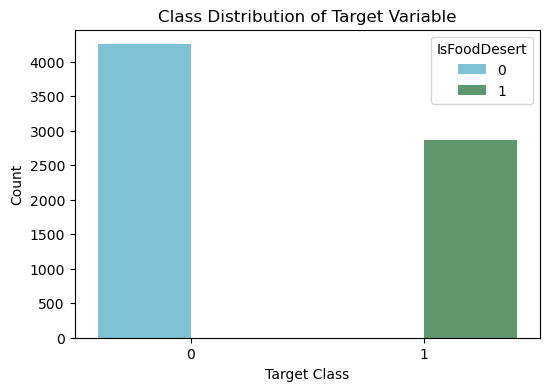

Class Distribution (%):
 0    59.724758
1    40.275242
Name: IsFoodDesert, dtype: float64


In [ ]:
# Check class distribution
# Extract specific colors from Set2 palette
color_dict = {0: '#71cae3',  # muted turquoise
              1: '#54a166'}  # muted green

plt.figure(figsize=(6, 4))
sns.countplot(x=selected_centroids_data["IsFoodDesert"],
              palette=color_dict,  # Use your custom color dictionary
              hue=selected_centroids_data["IsFoodDesert"]  # Use the same dataframe as x
              )  # Properly pass legend parameter

plt.title("Class Distribution of Target Variable")
plt.xlabel("Target Class")
plt.ylabel("Count")
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate class distribution
food_desert_pct = centroids_data["IsFoodDesert"].value_counts(normalize=True) * 100

# Rename index to meaningful labels
label_map = {0: 'Not Food Desert', 1: 'Food Desert'}
food_desert_df = food_desert_pct.rename(index=label_map).reset_index()
food_desert_df.columns = ['Class', 'Percentage']

# Define custom colors for each class
color_dict = {'Not Food Desert': '#71cae3',  # muted turquoise
              'Food Desert': '#54a166'}     # muted green
bar_colors = food_desert_df['Class'].map(color_dict)

# Plot
plt.figure(figsize=(6, 4))
ax = sns.barplot(data=food_desert_df, x='Class', y='Percentage', palette=bar_colors)

# Add percentage labels on each bar
for i, row in food_desert_df.iterrows():
    ax.text(i, row['Percentage'] + 1, f"{row['Percentage']:.1f}%",
            ha='center', va='bottom', fontsize=10)

plt.title("Total Food Desert Tracts Percentage")
plt.xlabel("Class")
plt.ylabel("Percentage (%)")
plt.ylim(0, 110)  # Add space for the label
plt.tight_layout()
plt.show()

# Save the plot to a file
# plt.savefig("/Image/class_dist_plot.png")
plt.show()

# Print class percentages
class_counts = selected_centroids_data["IsFoodDesert"].value_counts(normalize=True) * 100
print("Class Distribution (%):\n", class_counts)


In [ ]:
# Make sure the TractID column is properly converted to string type
selected_centroids_data.loc[:,'TractID'] = selected_centroids_data.loc[:,'TractID'].apply(lambda x: str(x))

/var/folders/c9/wtcfhbsj4_ggwscrqd_3_rpw0000gn/T/ipykernel_47736/513774251.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_centroids_data.loc[:,'TractID'] = selected_centroids_data.loc[:,'TractID'].apply(lambda x: str(x))


In [ ]:
selected_centroids_data.info() # check that there are no null values and all datatypes are correct

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7121 entries, 0 to 7120
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   TractID                 7121 non-null   object 
 1   StateName               7121 non-null   object 
 2   CountyName              7121 non-null   object 
 3   IsUrban                 7121 non-null   int64  
 4   LILA_Urban1_Rural10     7121 non-null   int64  
 5   LILA_UrbanHalf_Rural10  7121 non-null   int64  
 6   LILA_Urban1_Rural20     7121 non-null   int64  
 7   LILA_VehicleOr20Miles   7121 non-null   int64  
 8   IsLowIncome             7121 non-null   int64  
 9   LA_Urban1_Rural10       7121 non-null   int64  
 10  GEOID                   7121 non-null   int64  
 11  latitude                7121 non-null   float64
 12  longitude               7121 non-null   float64
 13  state                   7121 non-null   object 
 14  IsFoodDesert            7121 non-null   

In [ ]:
selected_centroids_data.describe()

,IsUrban,LILA_Urban1_Rural10,LILA_UrbanHalf_Rural10,LILA_Urban1_Rural20,LILA_VehicleOr20Miles,IsLowIncome,LA_Urban1_Rural10,GEOID,latitude,longitude,IsFoodDesert
count,7121.000000,7121.000000,7121.000000,7121.000000,7121.000000,7121.000000,7121.000000,7.121000e+03,7121.000000,7121.000000,7121.000000
mean,0.599635,0.219492,0.348968,0.177644,0.225671,0.523241,0.430136,2.406932e+10,34.132920,-86.445272,0.402752
std,0.490007,0.413931,0.476677,0.382239,0.418053,0.499495,0.495130,1.645696e+10,2.253994,3.688511,0.490486
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.001020e+09,29.183121,-94.555556,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.306703e+10,32.510740,-89.825328,0.000000
50%,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2.120796e+10,34.062782,-86.029997,0.000000
75%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,4.504500e+10,35.824299,-83.948766,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.718903e+10,39.115870,-78.601992,1.000000


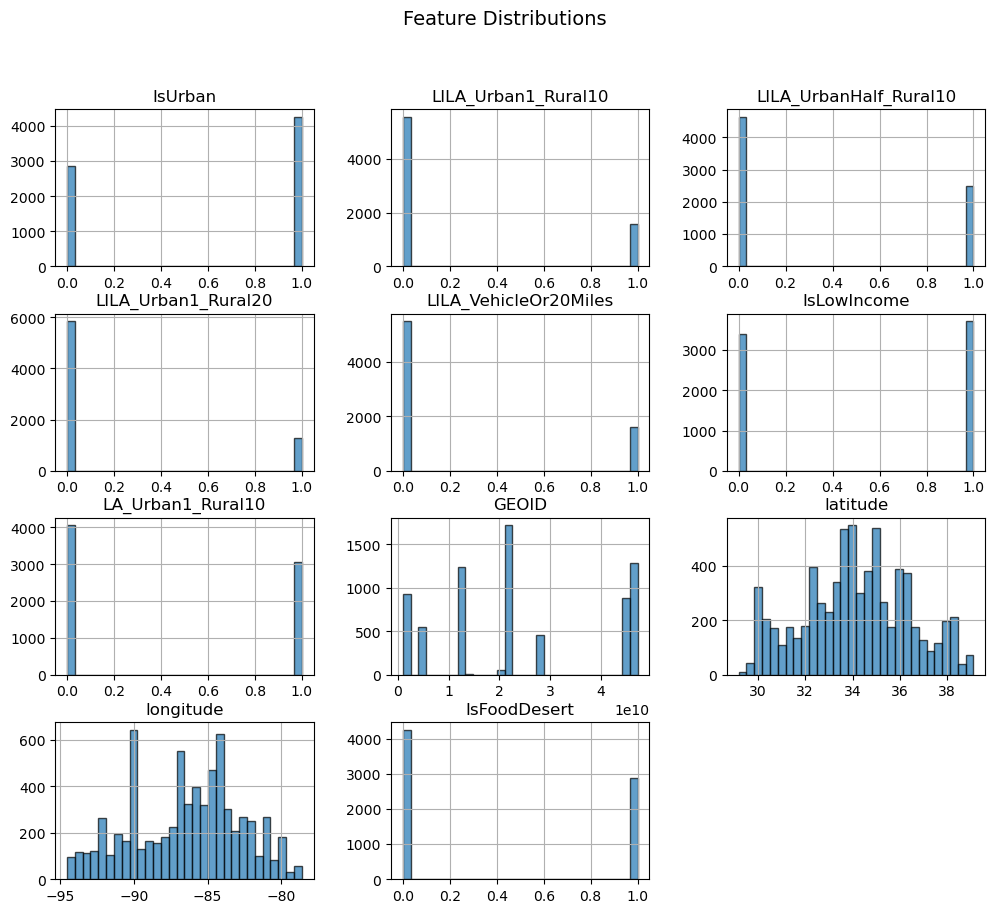

In [ ]:
# Look at distribution of numeric feature vars
# Select numerical columns
numeric_cols = selected_centroids_data.select_dtypes(include=['float64', 'int64']).columns

# Plot histograms
selected_centroids_data[numeric_cols].hist(figsize=(12,10), bins=30, edgecolor='black', alpha=0.7)
plt.suptitle("Feature Distributions", fontsize=14)
plt.show()

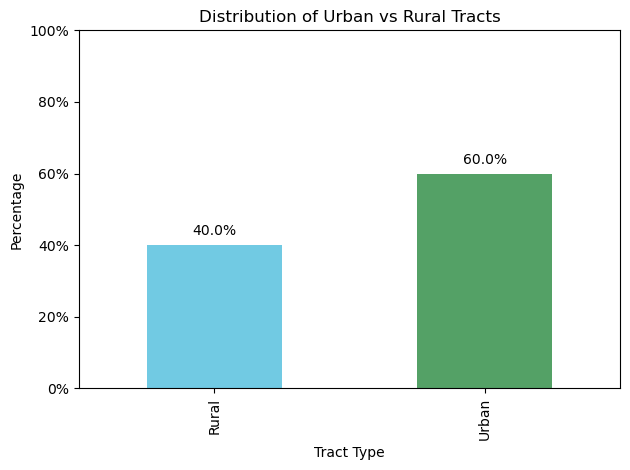

In [ ]:
urban_counts = selected_centroids_data["IsUrban"].value_counts(normalize=True).reset_index().sort_values(by="IsUrban", ascending=True)
urban_counts.columns = ["IsUrban", "Percentage"]

# If IsUrban is 0/1, make it more readable
label_map = {0: "Rural", 1: "Urban"}
urban_counts["Label"] = urban_counts["IsUrban"].map(label_map)

# Set index to Label for easier plotting
urban_counts.set_index("Label", inplace=True)

# Plot
ax = urban_counts["Percentage"].plot(
    kind="bar",
    color=[color_dict[0], color_dict[1]],
    ylim=(0, 1),
    legend=False
)

# Title and axis formatting
plt.title("Distribution of Urban vs Rural Tracts")
plt.xlabel("Tract Type")
plt.ylabel("Percentage")
ax.yaxis.set_major_formatter(plt.matplotlib.ticker.PercentFormatter(1))

# Add text labels on top of bars
for i, pct in enumerate(urban_counts["Percentage"]):
    ax.text(
        i,
        pct + 0.02,
        f"{pct:.1%}",
        ha='center',
        va='bottom',
        fontsize=10
    )

plt.tight_layout()
plt.show()


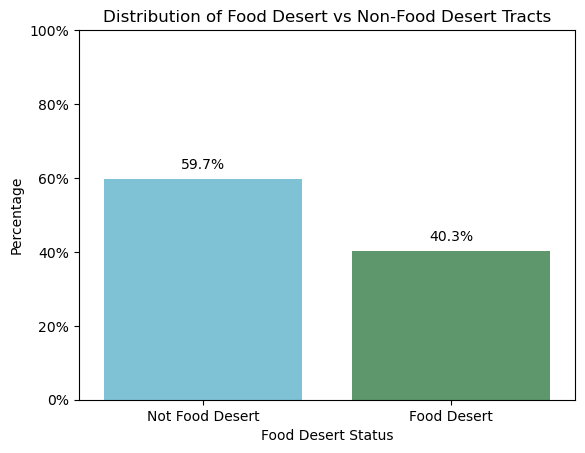

In [ ]:
# Plot 2: IsFoodDesert percentage
fd_counts = selected_centroids_data["IsFoodDesert"].value_counts(normalize=True).reset_index()
fd_counts.columns = ["IsFoodDesert", "Percentage"]

ax = sns.barplot(
    data=fd_counts,
    x="IsFoodDesert",
    y="Percentage",
    palette=[color_dict[i] for i in fd_counts["IsFoodDesert"]]
)
plt.title("Distribution of Food Desert vs Non-Food Desert Tracts")
plt.xticks([0, 1], ["Not Food Desert", "Food Desert"])
plt.xlabel("Food Desert Status")
plt.ylabel("Percentage")
plt.ylim(0, 1)
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.PercentFormatter(1))

# Add text labels
for i, row in fd_counts.iterrows():
    ax.text(
        i,
        row["Percentage"] + 0.02,
        f"{row['Percentage']:.1%}",
        ha='center',
        va='bottom',
        fontsize=10
    )

plt.show()



In [ ]:
# Plot 3: Urban/Rural vs Food Desert (stacked percent bars)
cross = pd.crosstab(
    selected_centroids_data["IsUrban"],
    selected_centroids_data["IsFoodDesert"],
    normalize="index"
).reset_index().melt(
    id_vars="IsUrban",
    var_name="IsFoodDesert",
    value_name="Percentage"
)

cross


,IsUrban,IsFoodDesert,Percentage
0,0,0,0.761136
1,1,0,0.487822
2,0,1,0.238864
3,1,1,0.512178


Urban area has 51% food desert. Rural Area has 24% food desert. Why? I thought rural area would have more food desert percentage.


In [ ]:
# check correlations
numeric_cols_df = selected_centroids_data[numeric_cols]

corr = numeric_cols_df.corr()["IsFoodDesert"].sort_values(ascending=False)
print("Feature Correlation with Target:\n", corr)


Feature Correlation with Target:
 IsFoodDesert              1.000000
LILA_UrbanHalf_Rural10    0.891558
IsLowIncome               0.783863
LILA_VehicleOr20Miles     0.657405
LILA_Urban1_Rural10       0.645771
LILA_Urban1_Rural20       0.565982
IsUrban                   0.273047
LA_Urban1_Rural10         0.190483
GEOID                    -0.050432
longitude                -0.062526
latitude                 -0.101973
Name: IsFoodDesert, dtype: float64


In [ ]:
categorical_cols = selected_centroids_data.select_dtypes(include=['object']).columns
categorical_cols


Index(['TractID', 'StateName', 'CountyName', 'state'], dtype='object')

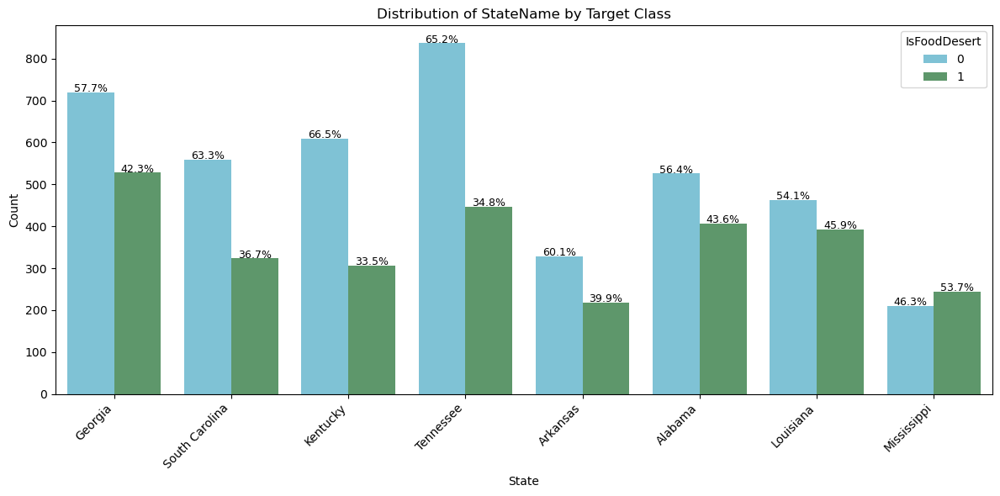

In [ ]:
plt.figure(figsize=(12, 6))
ax = sns.countplot(
    data=selected_centroids_data,
    x='StateName',
    hue='IsFoodDesert',
    palette=color_dict
)

plt.title("Distribution of StateName by Target Class")
plt.xticks(rotation=45, ha='right')
plt.ylabel("Count")
plt.xlabel("State")

# Get total counts per state
state_totals = selected_centroids_data.groupby('StateName').size().to_dict()

# Loop through each bar and annotate with percent
for p in ax.patches:
    state = p.get_x() + p.get_width() / 2
    height = p.get_height()

    # Get the corresponding StateName from the x location
    label = p.get_x() + p.get_width() / 2.0
    idx = int(p.get_x() + p.get_width() / 2.0)

    # x tick index corresponds to label order
    state_idx = round(p.get_x() + p.get_width() / 2.0)
    state_name = ax.get_xticklabels()[state_idx].get_text()

    total = state_totals.get(state_name, 1)  # fallback to 1 to avoid div-by-zero
    percent = height / total * 100

    if height > 0:
        ax.text(
            p.get_x() + p.get_width() / 2.,
            height + 1,
            f'{percent:.1f}%',
            ha="center",
            fontsize=9
        )

plt.tight_layout()
plt.show()


## GeoPandas Plots

In [ ]:
selected_centroids_data.columns

Index(['TractID', 'StateName', 'CountyName', 'IsUrban', 'LILA_Urban1_Rural10',
       'LILA_UrbanHalf_Rural10', 'LILA_Urban1_Rural20',
       'LILA_VehicleOr20Miles', 'IsLowIncome', 'LA_Urban1_Rural10', 'GEOID',
       'latitude', 'longitude', 'state', 'IsFoodDesert'],
      dtype='object')

In [ ]:
!pwd

/Users/yu-shenglee/Desktop/dev/ucb_mids_207_Final_Project_Food_Deserts


<Axes: >

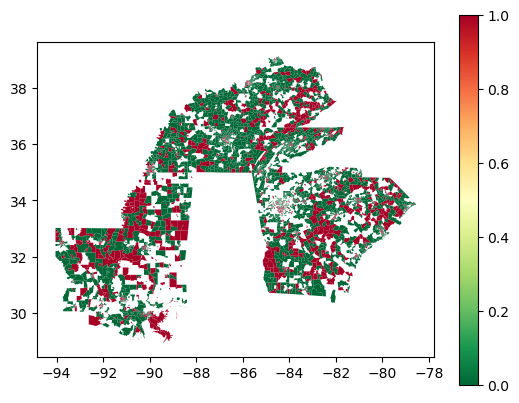

In [ ]:
# Load shapefile and your data
tracts = gpd.read_file("Data/cb_2020_us_tract_500k/cb_2020_us_tract_500k.shp")
merged = tracts.merge(selected_centroids_data, left_on='GEOID', right_on='TractID')
merged
# Plot
merged.plot(column='IsFoodDesert', cmap='RdYlGn_r', legend=True)


### Tract and Urban Area Distribution

In [ ]:
for c in merged.columns:
    print(c)

STATEFP
COUNTYFP
TRACTCE
AFFGEOID
GEOID_x
NAME
NAMELSAD
STUSPS
NAMELSADCO
STATE_NAME
LSAD
ALAND
AWATER
geometry
TractID
StateName
CountyName
IsUrban
LILA_Urban1_Rural10
LILA_UrbanHalf_Rural10
LILA_Urban1_Rural20
LILA_VehicleOr20Miles
IsLowIncome
LA_Urban1_Rural10
GEOID_y
latitude
longitude
state
IsFoodDesert


In [ ]:
# 1. Load shapefile (GeoDataFrame)
tracts_gdf = gpd.read_file("Data/cb_2020_us_tract_500k/cb_2020_us_tract_500k.shp")

# 2. Ensure matching keys and string types
tracts_gdf['GEOID'] = tracts_gdf['GEOID'].astype(str)
selected_centroids_data['TractID'] = selected_centroids_data['TractID'].astype(str)

# 3. Merge with additional columns (StateName, CountyName, IsUrban)
merged_gdf = tracts_gdf.merge(
    selected_centroids_data[['TractID', 'IsUrban', 'StateName', 'CountyName']],
    left_on='GEOID',
    right_on='TractID',
    how='inner'
)

# 4. Color map for urban/rural
color_map = {
    0: '#71cae3',  # rural
    1: '#54a166',  # urban
}
merged_gdf['UrbanType'] = merged_gdf['IsUrban'].map({0: 'Rural', 1: 'Urban'})

# 5. Convert CRS and to GeoJSON
merged_gdf = merged_gdf.to_crs(epsg=4326)
geojson_data = merged_gdf.__geo_interface__

# 6. Plotly choropleth with state/county in hover
fig = px.choropleth_mapbox(
    merged_gdf,
    geojson=geojson_data,
    locations=merged_gdf.index,
    color="UrbanType",
    color_discrete_map={'Rural': '#71cae3', 'Urban': '#54a166'},
    hover_data={
        "GEOID": True,
        "StateName": True,
        "CountyName": True,
        "UrbanType": True
    },
    mapbox_style="carto-positron",
    center={"lat": 37.8, "lon": -96},
    zoom=3,
    opacity=0.6
)

fig.update_layout(title="Urban vs Rural Census Tracts (with State and County Info)", margin={"r":0,"t":40,"l":0,"b":0})
fig.show()



/var/folders/c9/wtcfhbsj4_ggwscrqd_3_rpw0000gn/T/ipykernel_47736/226787412.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Food Desert Concentration by County

In [ ]:
# Load U.S. counties shapefile
counties_gdf = gpd.read_file("Data/cb_2020_us_county_20m/cb_2020_us_county_20m.shp")  # Download from Census if needed
counties_gdf['GEOID'] = counties_gdf['STATEFP'] + counties_gdf['COUNTYFP']  # Full 5-digit FIPS code

# Ensure TractID is string for matching
selected_centroids_data['TractID'] = selected_centroids_data['TractID'].astype(str)

# Create county FIPS (if not already available)
selected_centroids_data['CountyFIPS'] = selected_centroids_data['TractID'].str[:5]

# Group by county and calculate % food desert
county_stats = selected_centroids_data.groupby('CountyFIPS').agg(
    total_tracts=('TractID', 'count'),
    food_deserts=('IsFoodDesert', 'sum')
).reset_index()

county_stats['food_desert_pct'] = county_stats['food_deserts'] / county_stats['total_tracts'] * 100

# Merge with county shapefile
merged_counties = counties_gdf.merge(
    county_stats,
    left_on='GEOID',
    right_on='CountyFIPS',
    how='inner'
)

# Convert to WGS84
merged_counties = merged_counties.to_crs(epsg=4326)



/var/folders/c9/wtcfhbsj4_ggwscrqd_3_rpw0000gn/T/ipykernel_47736/2457005170.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/c9/wtcfhbsj4_ggwscrqd_3_rpw0000gn/T/ipykernel_47736/2457005170.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Quick mapping (you can also load from a file if needed)
fips_to_state = {
    '01': 'Alabama', '02': 'Alaska', '04': 'Arizona', '05': 'Arkansas',
    '06': 'California', '08': 'Colorado', '09': 'Connecticut', '10': 'Delaware',
    '11': 'District of Columbia', '12': 'Florida', '13': 'Georgia', '15': 'Hawaii',
    '16': 'Idaho', '17': 'Illinois', '18': 'Indiana', '19': 'Iowa',
    '20': 'Kansas', '21': 'Kentucky', '22': 'Louisiana', '23': 'Maine',
    '24': 'Maryland', '25': 'Massachusetts', '26': 'Michigan', '27': 'Minnesota',
    '28': 'Mississippi', '29': 'Missouri', '30': 'Montana', '31': 'Nebraska',
    '32': 'Nevada', '33': 'New Hampshire', '34': 'New Jersey', '35': 'New Mexico',
    '36': 'New York', '37': 'North Carolina', '38': 'North Dakota', '39': 'Ohio',
    '40': 'Oklahoma', '41': 'Oregon', '42': 'Pennsylvania', '44': 'Rhode Island',
    '45': 'South Carolina', '46': 'South Dakota', '47': 'Tennessee', '48': 'Texas',
    '49': 'Utah', '50': 'Vermont', '51': 'Virginia', '53': 'Washington',
    '54': 'West Virginia', '55': 'Wisconsin', '56': 'Wyoming'
}

# Map it in your GeoDataFrame
merged_counties['StateName'] = merged_counties['STATEFP'].map(fips_to_state)


In [ ]:
fig = px.choropleth_mapbox(
    merged_counties,
    geojson=merged_counties.__geo_interface__,
    locations=merged_counties.index,
    color="food_desert_pct",
    color_continuous_scale="Reds",
    hover_data={
        "StateName": True,         # <-- new line for state name
        "NAME": True,              # County name
        "food_desert_pct": ':.1f',
        "total_tracts": True,
        "food_deserts": True
    },
    mapbox_style="carto-positron",
    center={"lat": 37.8, "lon": -96},
    zoom=3,
    opacity=0.7
)

fig.update_layout(
    title="Percentage of Food Desert Census Tracts per County",
    margin={"r":0,"t":40,"l":0,"b":0}
)
fig.show()


# EDA for Images

In [18]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from collections import Counter
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import imagehash
from tqdm import tqdm


DATA_PATH = 'Data/Pictures/' # replace with your path
img_paths = []

for subfolder in os.listdir(DATA_PATH):
    img_subfolder = os.path.join(DATA_PATH, subfolder)
    if os.path.isdir(img_subfolder):
        for filename in os.listdir(img_subfolder):
            img_path = os.path.join(img_subfolder, filename)
            if os.path.isfile(img_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                img_paths.append(img_path)


### 1. Image Size and Channel Distribution

In [ ]:
image_shapes = []

for path in tqdm(img_paths):
    with PILImage.open(path) as img:
        shape = img.size + (len(img.getbands()),)  # (width, height, channels)
        image_shapes.append(shape)

shape_counts = Counter(image_shapes)
print("Image shape distribution:", shape_counts)

# Plot common shapes
top_shapes = dict(shape_counts.most_common(10))
plt.barh([str(k) for k in top_shapes.keys()], top_shapes.values())
plt.xlabel("Count")
plt.title("Top 10 Image Shapes")
plt.show()


### 2. Visual Inspection

In [20]:
sample_paths = random.sample(img_paths, 9)
fig, axs = plt.subplots(3, 3, figsize=(10, 10))

for ax, path in zip(axs.flat, sample_paths):
    img = PILImage.open(path)
    ax.imshow(img)
    ax.set_title(os.path.basename(path))
    ax.axis('off')

plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

### 3. Pixel Intensity Distribution

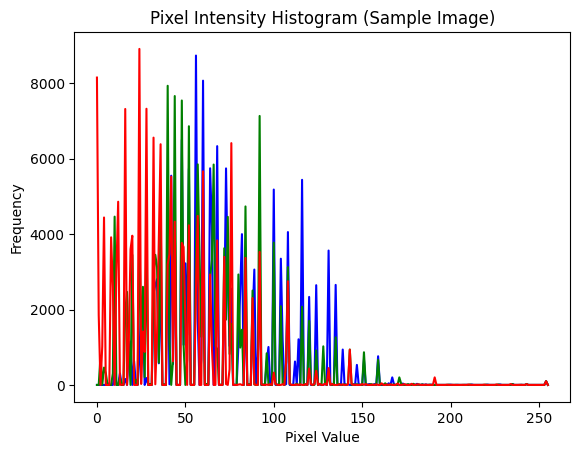

In [21]:
import cv2

img = cv2.imread(sample_paths[0])
colors = ('b', 'g', 'r')
for i, col in enumerate(colors):
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    plt.plot(hist, color=col)
plt.title('Pixel Intensity Histogram (Sample Image)')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

### 4. Class Distribution

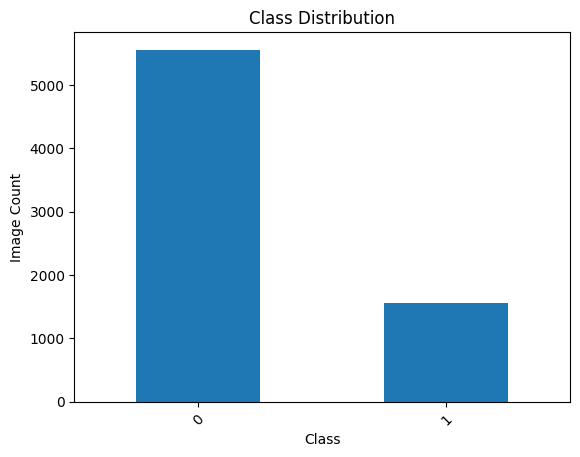

In [22]:
labels = [os.path.basename(p).split('_')[0] for p in img_paths]
label_counts = pd.Series(labels).value_counts()

label_counts.plot(kind='bar')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Image Count')
plt.xticks(rotation=45)
plt.show()

In [37]:
label_counts = pd.DataFrame(label_counts)
label_counts['Percentage'] = label_counts['count'] / label_counts['count'].sum() * 100
label_counts

,count,Percentage
0,5558,77.213698
1,1563,21.881925
Percentage,0 ...,0 ...


### 5. Image Brightness Distribution

100%|██████████| 500/500 [00:05<00:00, 88.42it/s] 


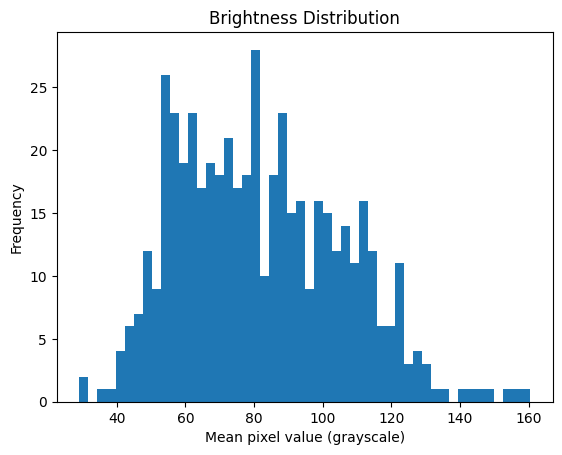

In [28]:
def get_brightness(img):
    gray = img.convert('L') # grayscale
    return np.mean(np.array(gray))

brightness_vals = [get_brightness(PILImage.open(p)) for p in tqdm(img_paths[:500])]

plt.hist(brightness_vals, bins=50)
plt.title('Brightness Distribution')
plt.xlabel('Mean pixel value (grayscale)')
plt.ylabel('Frequency')
plt.show()

### 6. Check for Duplicated Using Hashes

In [29]:
import imagehash

hashes = {}
for path in tqdm(img_paths[:1000]):
    with PILImage.open(path) as img:
        h = str(imagehash.average_hash(img))
        if h in hashes:
            print(f'Duplicate: {path} and {hashes[h]}')
        else:
            hashes[h] = path

100%|██████████| 1000/1000 [00:10<00:00, 95.45it/s]


### 7. Color Clustering using KMeans (Dominant Colors)

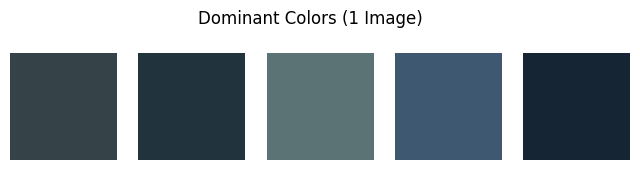

In [32]:
# Fix: Ensure image is in RGB format before reshaping
img = PILImage.open(random.choice(img_paths)).convert('RGB').resize((64, 64))
img_np = np.array(img).reshape(-1, 3)

kmeans = KMeans(n_clusters=5, random_state=0, n_init=10).fit(img_np) # Add n_init for KMeans
colors = kmeans.cluster_centers_.astype(int)

plt.figure(figsize=(8, 2))
for i, color in enumerate(colors):
    plt.subplot(1, 5, i + 1)
    plt.imshow([[color / 255]])
    plt.axis('off')
plt.suptitle("Dominant Colors (1 Image)")
plt.show()

### 8. PCA for Image Clustering

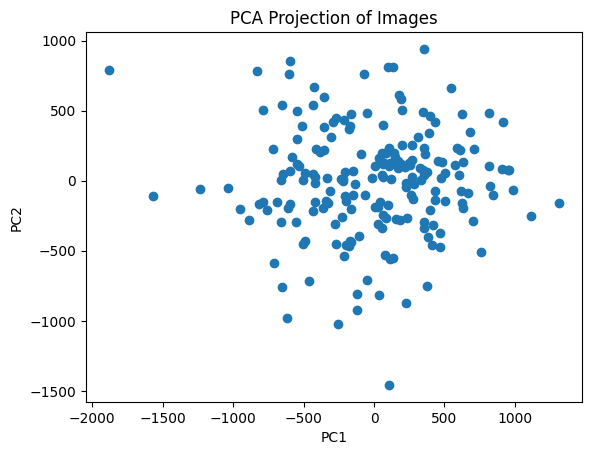

In [33]:
def img_to_flat_array(path, size=(32, 32)):
    img = PILImage.open(path).resize(size)
    return np.array(img).flatten()

sample_imgs = random.sample(img_paths, 200)
X = np.array([img_to_flat_array(p) for p in sample_imgs])

X_pca = PCA(n_components=2).fit_transform(X)
plt.scatter(X_pca[:, 0], X_pca[:, 1])
plt.title("PCA Projection of Images")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()
